<a href="https://colab.research.google.com/github/Jacqueline202726/RDFIA-TP/blob/main/2_b_Visualizing_Neural_Networks.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 2-b: Visualizing Neural Networks

#### To keep your modifications in case you want to come back later to this colab, do *File -> Save a copy in Drive*.



In [1]:
import torch
import torchvision
from torchvision import transforms
import random
import numpy as np
from scipy.ndimage.filters import gaussian_filter1d
import matplotlib.pyplot as plt
from PIL import Image
import os

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'viridis'

<ipython-input-1-489f8c877b90>:6: DeprecationWarning: Please import `gaussian_filter1d` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  from scipy.ndimage.filters import gaussian_filter1d


## Functions and useful variables

In [2]:
SQUEEZENET_MEAN = np.array([0.485, 0.456, 0.406], dtype=np.float32)
SQUEEZENET_STD = np.array([0.229, 0.224, 0.225], dtype=np.float32)

def preprocess(img, size=224):
    transform = transforms.Compose([
        transforms.Resize(size),
        transforms.ToTensor(),
        transforms.Normalize(mean=SQUEEZENET_MEAN.tolist(),
                    std=SQUEEZENET_STD.tolist()),
        transforms.Lambda(lambda x: x[None]),  # add one dimension
    ])
    return transform(img)

def deprocess(img, should_rescale=True):
    transform = transforms.Compose([
        transforms.Lambda(lambda x: x[0]),
        transforms.Normalize(mean=[0, 0, 0], std=(1.0 / SQUEEZENET_STD).tolist()),
        transforms.Normalize(mean=(-SQUEEZENET_MEAN).tolist(), std=[1, 1, 1]),
        transforms.Lambda(rescale) if should_rescale else transforms.Lambda(lambda x: x),
        transforms.ToPILImage(),
    ])
    return transform(img)

def rescale(x):
    low, high = x.min(), x.max()
    x_rescaled = (x - low) / (high - low)
    return x_rescaled

def blur_image(X, sigma=1):
    X_np = X.cpu().clone().detach().numpy()
    X_np = gaussian_filter1d(X_np, sigma, axis=2)
    X_np = gaussian_filter1d(X_np, sigma, axis=3)
    X.copy_(torch.Tensor(X_np).type_as(X))
    return X

def jitter(X, ox, oy):
    """
    Helper function to randomly jitter an image.

    Inputs
    - X: PyTorch Tensor of shape (N, C, H, W)
    - ox, oy: Integers giving number of pixels to jitter along W and H axes

    Returns: A new PyTorch Tensor of shape (N, C, H, W)
    """
    if ox != 0:
        left = X[:, :, :, :-ox]
        right = X[:, :, :, -ox:]
        X = torch.cat([right, left], dim=3)
    if oy != 0:
        top = X[:, :, :-oy]
        bottom = X[:, :, -oy:]
        X = torch.cat([bottom, top], dim=2)
    return X

## Load the model

For this TME, we will use the Squeezenet model which is a light model pre-trained on ImageNet. This model will be frozen: the goal is not to modify or train the weights but to study them.

In [3]:
# Load the model
model = torchvision.models.squeezenet1_1(pretrained=True)

# Model in test mode
model.eval()

# Freeze the weights
for param in model.parameters():
    param.requires_grad = False

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=SqueezeNet1_1_Weights.IMAGENET1K_V1`. You can also use `weights=SqueezeNet1_1_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/squeezenet1_1-b8a52dc0.pth" to /root/.cache/torch/hub/checkpoints/squeezenet1_1-b8a52dc0.pth
100%|██████████| 4.73M/4.73M [00:00<00:00, 40.5MB/s]


## Load example images

This will fill the variables `X, y, class_names` with 25 examples from the validation set of ImageNet. `X` containes the images, `y` the class index of each image, and `class_names` a dictionary giving the class name from its index.

In [4]:
# Download data
#!wget https://github.com/cdancette/deep-learning-polytech-tp6-7/raw/master/tp9/imagenet_val_25.npz
!wget https://github.com/rdfia/rdfia.github.io/raw/master/data/3-b/imagenet_val_25.npz

--2024-12-02 00:14:35--  https://github.com/rdfia/rdfia.github.io/raw/master/data/3-b/imagenet_val_25.npz
Resolving github.com (github.com)... 20.27.177.113
Connecting to github.com (github.com)|20.27.177.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/data/3-b/imagenet_val_25.npz [following]
--2024-12-02 00:14:36--  https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/data/3-b/imagenet_val_25.npz
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.111.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3940548 (3.8M) [application/octet-stream]
Saving to: ‘imagenet_val_25.npz’

imagenet_val_25.npz 100%[===================>]   3.76M  11.3MB/s    in 0.3s    

2024-12-02 00:14:37 (11.3 MB/s) - ‘imagenet_val_25.npz

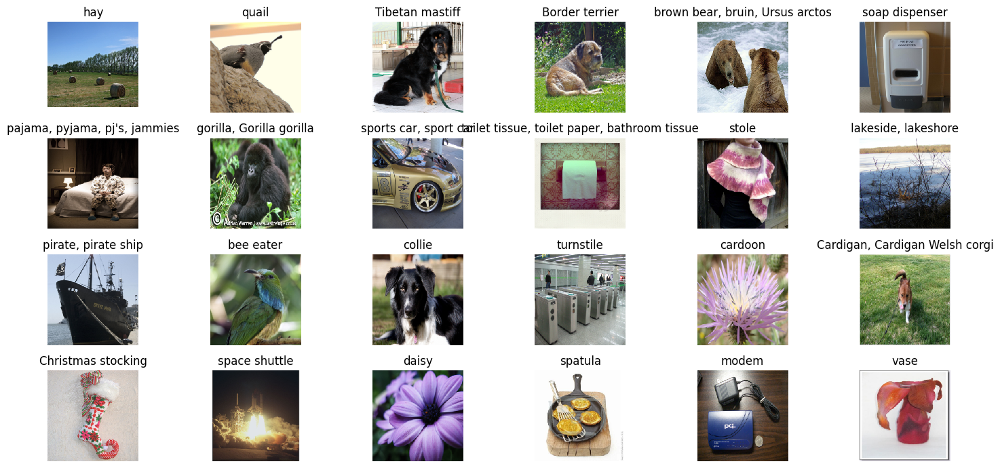

In [5]:
f = np.load("imagenet_val_25.npz", allow_pickle=True)
X, y, class_names = f["X"], f["y"], f["label_map"].item()
class_names_to_id = {name: id for id, name in class_names.items()}

plt.figure(figsize=(15, 7))
for i in range(24):
    plt.subplot(4, 6, i + 1)
    plt.imshow(X[i])
    plt.title(class_names[y[i]])
    plt.axis('off')
plt.gcf().tight_layout()

# Saliency Maps

Calculate the saliency map for 5 examples out of the 25 loaded ones following the instructions of the TP guide.

**Hint :** To choose 1 particular value in each row of a matrix, you can do this:

```python
x = torch.Tensor([[0.1, 0.0, 0.5, 0.1, 0.1],
                  [0.0, 0.1, 0.0, 0.6, 0.2],
                  [0.7, 0.1, 0.1, 0.3, 0.0]])
x[np.arange(3), [2, 3, 0]]
# 0.5000
# 0.6000
# 0.7000
#[torch.FloatTensor of size 3]
```

In [6]:
def compute_saliency_maps(X, y, model):
    """
    Compute a class saliency map using the model for images X and labels y.

    Input:
    - X: Input images; Tensor of shape (N, 3, H, W)
    - y: Labels for X; LongTensor of shape (N,)
    - model: A pretrained CNN that will be used to compute the saliency map.

    Returns:
    - saliency: A Tensor of shape (N, H, W) giving the saliency maps for the input
    images.
    """
    # activate gradients on X
    X.requires_grad = True
    saliency = None
    ##############################################################################
    # TODO: Implement this function. Perform a forward and backward pass through #
    # the model to compute the gradient of the correct class score with respect  #
    # to each input image.                                                       #
    # You first want to extract the logits for the correct  scores (not the loss),#
    # and then compute the gradients with a backward pass.                       #
    ##############################################################################
    # forward pass
    scores=model(X) #(N,C)
    # extract the logits for the correct scores
    logits=scores.gather(1,y.view(-1,1)).squeeze() #(N,)
    # backward pass on the logits
    # set the gradient calculation weights of every element in the logits to 1, to sum up the gradient of all the classes
    logits.backward(torch.ones_like(logits))

    # take the absolute value of the gradient since the Saliency Maps requires nonnegative values (gradients)
    saliency=X.grad.abs() #(N,3,H,W)

    # Take the maximum value over the 3 input channels (for each of N images).
    saliency = saliency.max(dim=1).values  # (N, H, W)
    ##############################################################################
    #                             END OF YOUR CODE                               #
    ##############################################################################
    return saliency

Test your code with the following function:

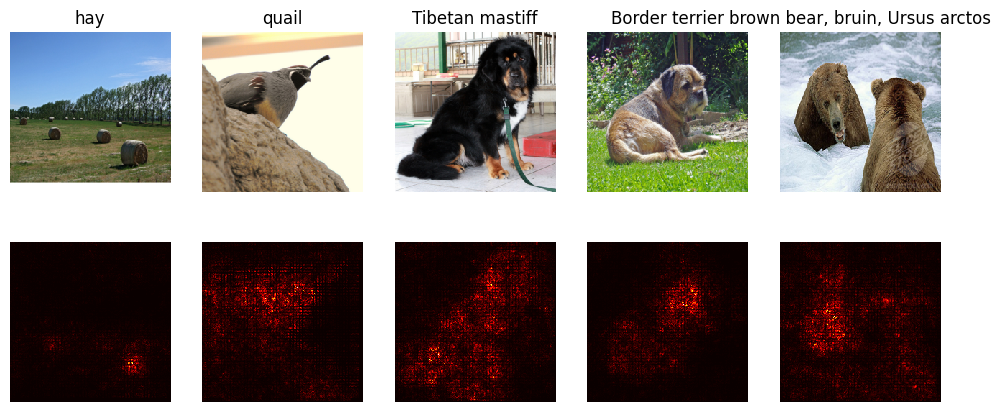

In [7]:
def show_saliency_maps(X, y, model):
    # Convert X and y from numpy arrays to Torch Tensors
    X_tensor = torch.cat([preprocess(Image.fromarray(x)) for x in X], dim=0)
    y_tensor = torch.LongTensor(y)

    # Compute saliency maps for images in X
    saliency = compute_saliency_maps(X_tensor, y_tensor, model)

    # Convert the saliency map from Torch Tensor to numpy array and show images
    # and saliency maps together.
    saliency = saliency.numpy()
    N = X.shape[0]
    for i in range(N):
        plt.subplot(2, N, i + 1)
        plt.imshow(X[i])
        plt.axis('off')
        plt.title(class_names[y[i]])
        plt.subplot(2, N, N + i + 1)
        plt.imshow(saliency[i], cmap=plt.cm.hot)
        plt.axis('off')
        plt.gcf().set_size_inches(12, 5)
    plt.show()

for i in range(1): # range(5) pour tester toutes les images
    show_saliency_maps(X[5*i:5*i+5], y[5*i:5*i+5], model)

In [16]:
import math

def show_saliency_maps(X, y, model, save_name=None, title=True):
    # Convert X and y from numpy arrays to Torch Tensors
    X_tensor = torch.cat([preprocess(Image.fromarray(x)) for x in X], dim=0)
    y_tensor = torch.LongTensor(y)

    if title:
        y_hat = model(X_tensor).argmax(1).tolist()
        logit = torch.nn.Softmax(dim=1)(model(X_tensor)) * 100
        y_hat_proba, y_hat = logit.max(1)
        y_hat = y_hat.int().tolist()
        y_hat_proba = y_hat_proba.int().tolist()
        y_true_proba = logit[np.arange(X_tensor.size(0)), y].int()
        display(y_true_proba)

    # Compute saliency maps for images in X
    saliency = compute_saliency_maps(X_tensor, y_tensor, model)
    saliency_prediction = compute_saliency_maps(X_tensor, torch.tensor(y_hat), model)

    # Convert the saliency map from Torch Tensor to numpy array
    saliency = saliency.numpy()
    saliency_prediction = saliency_prediction.numpy()

    # Define the maximum number of columns
    max_columns = 5
    N = X.shape[0]

    # Calculate the required number of rows (2 rows for each set: image and saliency map)
    num_rows = math.ceil(N / max_columns)

    # Plot and save the original images
    fig1, axs1 = plt.subplots(1, max_columns, figsize=(15, num_rows * 3))
    # fig1.suptitle("Original images", fontsize="x-large", fontweight="roman")
    for col, ax in enumerate(axs1):
        ax.imshow(X[col])
        ax.axis("off")
        if title:
            true_label = class_names[y[col]].split(",")[0]
            pred_label = class_names[y_hat[col]].split(",")[0]
            ax.set_title(
                f"True label: {true_label}, {y_true_proba[col]}%\nPrediction: {pred_label}, {y_hat_proba[col]}%"
            )
    if save_name:
        fig1.savefig(f"{save_name}_originals.png", dpi=100, bbox_inches="tight")
    plt.show()
    plt.close(fig1)

    # Plot and save the saliency map of the true class
    fig2, axs2 = plt.subplots(1, max_columns, figsize=(15, num_rows * 3))
    fig2.suptitle("Saliency map of the true class", fontsize="x-large", fontweight="roman")
    for col, ax in enumerate(axs2):
        ax.imshow(saliency[col], cmap=plt.cm.hot)
        ax.axis("off")
    if save_name:
        fig2.savefig(f"{save_name}_true_saliency.png", dpi=100, bbox_inches="tight")
    plt.show()
    plt.close(fig2)

    # Plot and save the saliency map of the predicted class
    fig3, axs3 = plt.subplots(1, max_columns, figsize=(15, num_rows * 3))
    fig3.suptitle("Saliency map of the predicted class", fontsize="x-large", fontweight="roman")
    for col, ax in enumerate(axs3):
        ax.imshow(saliency_prediction[col], cmap=plt.cm.hot)
        ax.axis("off")
    if save_name:
        fig3.savefig(f"{save_name}_predicted_saliency.png", dpi=100, bbox_inches="tight")
    plt.show()
    plt.close(fig3)


    # Optionally show the plots if no save_name is provided
    if not save_name:
        plt.show()


tensor([99, 90, 89,  8, 98], dtype=torch.int32)

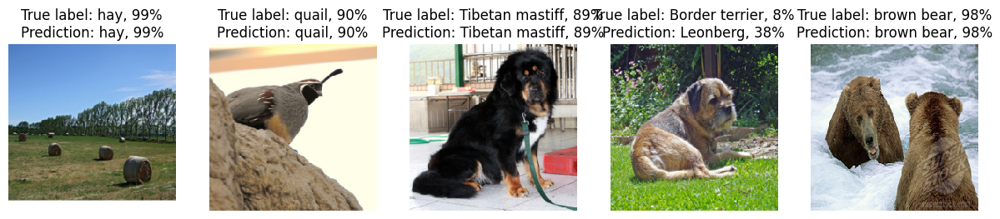

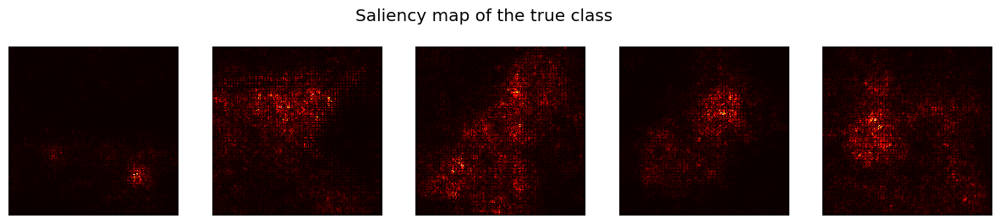

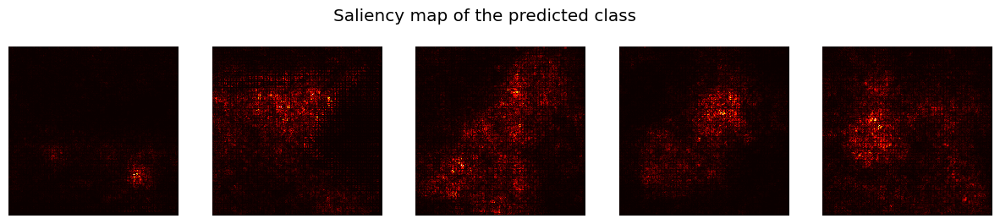

In [17]:
for i in range(1):  # range(5) to test all images
    show_saliency_maps(X[5*i:5*i+5], y[5*i:5*i+5], model, save_name=f"saliency_maps_{i}.png")

In [7]:
vgg16 = torchvision.models.vgg16(weights=torchvision.models.VGG16_Weights.DEFAULT)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:07<00:00, 74.6MB/s]


tensor([99, 92, 99, 99, 99], dtype=torch.int32)

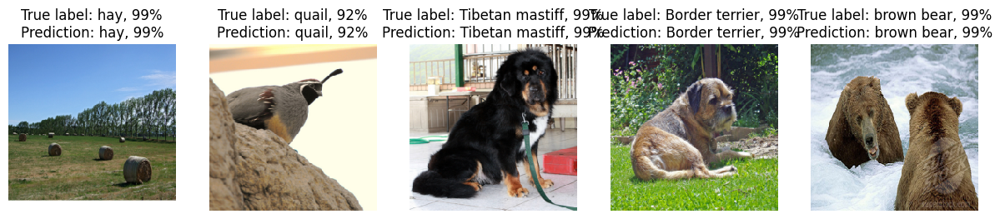

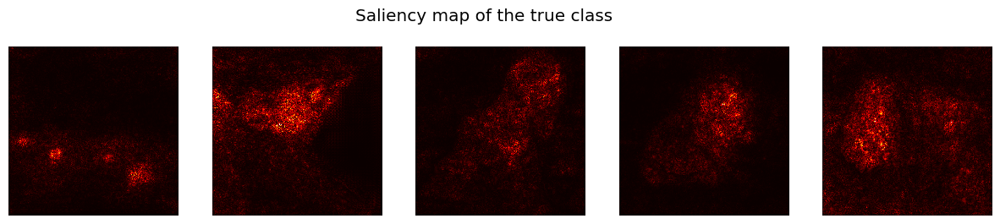

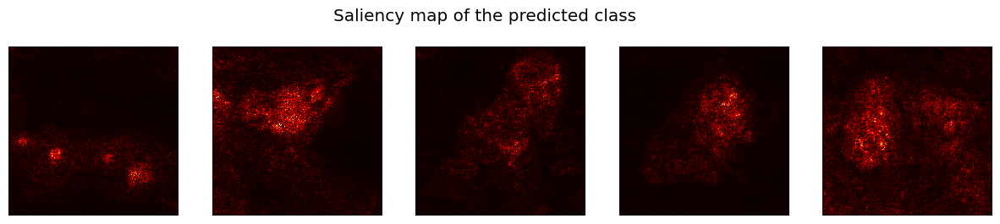

In [20]:
for i in range(1): # range(5) pour tester toutes les images
    show_saliency_maps(X[5*i:5*i+5], y[5*i:5*i+5], vgg16,save_name=f"saliency_maps_vgg16_{i}.png")

# Adversarial Examples (Fooling Images)

Write the code to calculate an image such that it will be classified in a `target_y` different from the real class (by modifying the image and not the network parameters). See the TP guide for instructions.

**The first two blocks will allow you to perform tests in an interactive way** to write and test your code. Once your code seems to work, complete the function in the 3rd block and test on various images in the 4th block.

In [21]:
# Initialize tests
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[0])))
target_y = class_names_to_id['stingray']  # Desired class
X_fooling = X_tensor.clone()
X_fooling.requires_grad = True
learning_rate = 1

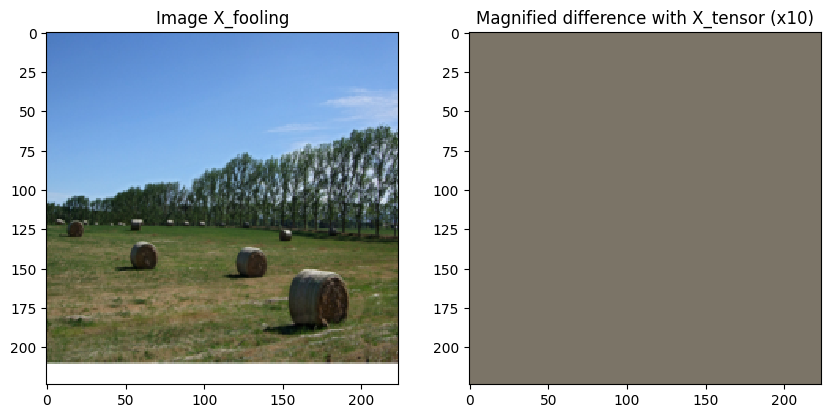

In [22]:
# TODO write your code to test here

# Visualize the image X_folling and its modifications
plt.subplot(1, 2, 1)
plt.imshow(np.asarray(deprocess(X_fooling.clone())).astype(np.uint8))
plt.title("Image X_fooling")
plt.subplot(1, 2, 2)
plt.imshow(np.asarray(deprocess(10* (X_fooling - X_tensor), should_rescale=False)))
plt.title("Magnified difference with X_tensor (x10)")
plt.show()

In [23]:
def make_fooling_image(X, target_y, model):
    """
    Generate a fooling image that is close to X, but that the model classifies
    as target_y.

    Inputs:
    - X: Input image; Tensor of shape (1, 3, 224, 224)
    - target_y: An integer in the range [0, 1000)
    - model: A pretrained CNN

    Returns:
    - X_fooling: An image that is close to X, but that is classifed as target_y
    by the model.
    """
    # Initialize our fooling image to the input image, enable gradients.
    X_fooling = X.clone()
    X_fooling.requires_grad = True

    learning_rate = 1
    ##############################################################################
    # TODO: Generate a fooling image X_fooling that the model will classify as   #
    # the class target_y. You should perform gradient ascent on the score of the #
    # target class, stopping when the model is fooled.                           #
    # When computing an update step, first normalize the gradient:               #
    #   dX = learning_rate * grad / ||grad||_2                                   #
    #                                                                            #
    # You should write a training loop.                                          #
    #                                                                            #
    # HINT: For most examples, you should be able to generate a fooling image    #
    # in fewer than 100 iterations of gradient ascent.                           #
    # You can print your progress over iterations to check your algorithm.       #
    # HINT: Remember to reset gradients at each step                             #
    # HINT: update shouldn't be tracked by the autograd (see for example         #
    # https://pytorch.org/tutorials/beginner/examples_autograd/two_layer_net_autograd.html#sphx-glr-beginner-examples-autograd-two-layer-net-autograd-py #
    ##############################################################################
    for epoch in range(100):
      # forward pass
      scores=model(X_fooling) #(1,1000)

      # get predicted class and score
      pred_score,pred_class=torch.max(scores,dim=1)
      pred_score,pred_class=pred_score.item(),pred_class.item()

      # get the score of the target class
      target_score=scores[:,target_y].squeeze()

      # print the progress over iterations
      print(f"Iteration {epoch+1}: target score {target_score.item():.3f}, max score {pred_score:.3f}")

      # stop when the model is fooled (meaning when the predicted class equals target class(target_y))
      if pred_class == target_y:
          print("The model is fooled.")
          break

      # backward pass
      target_score.backward()

      # update the step using L2 normalization dX = learning_rate * grad / ||grad||_2
      X_fooling.grad *= learning_rate / torch.linalg.norm(X_fooling.grad)
      X_fooling.data += X_fooling.grad.data

      # reset gradients at each step
      X_fooling.grad.data.zero_()

    ##############################################################################
    #                             END OF YOUR CODE                               #
    ##############################################################################
    return X_fooling

Iteration 1: target score 7.414, max score 25.148
Iteration 2: target score 11.349, max score 28.782
Iteration 3: target score 15.755, max score 31.915
Iteration 4: target score 20.142, max score 34.636
Iteration 5: target score 24.709, max score 37.816
Iteration 6: target score 29.031, max score 39.150
Iteration 7: target score 33.475, max score 42.849
Iteration 8: target score 38.330, max score 44.445
Iteration 9: target score 42.695, max score 47.602
Iteration 10: target score 46.027, max score 48.367
Iteration 11: target score 49.121, max score 51.848
Iteration 12: target score 52.603, max score 53.616
Iteration 13: target score 56.236, max score 56.410
Iteration 14: target score 59.641, max score 59.641
The model is fooled.


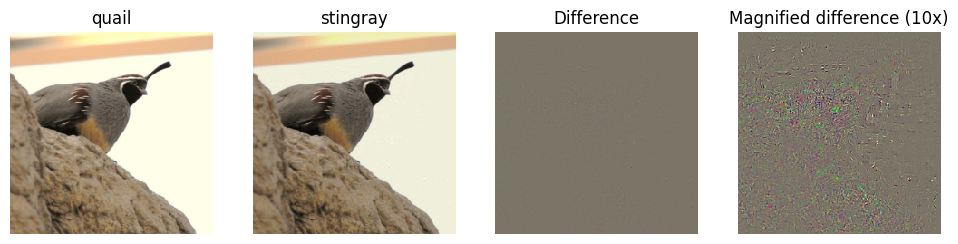

In [24]:
# Index of the image to modify and the target class
idx = 1
target_y = class_names_to_id['stingray']

# Preparation of tensor X and it's "fooling" version
X_tensor = torch.cat([preprocess(Image.fromarray(x)) for x in X], dim=0)
X_fooling = make_fooling_image(X_tensor[idx:idx+1], target_y, model)

# Check the predicted class
scores = model(X_fooling)
assert target_y == scores.data.max(1)[1][0], 'The model is not fooled!'

# Display
X_fooling_np = deprocess(X_fooling.clone())
X_fooling_np = np.asarray(X_fooling_np).astype(np.uint8)

plt.subplot(1, 4, 1)
plt.imshow(X[idx])
plt.title(class_names[y[idx]])
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(X_fooling_np)
plt.title(class_names[target_y])
plt.axis('off')

plt.subplot(1, 4, 3)
X_pre = preprocess(Image.fromarray(X[idx]))
diff = np.asarray(deprocess(X_fooling - X_pre, should_rescale=False))
plt.imshow(diff)
plt.title('Difference')
plt.axis('off')

plt.subplot(1, 4, 4)
diff = np.asarray(deprocess(10 * (X_fooling - X_pre), should_rescale=False))
plt.imshow(diff)
plt.title('Magnified difference (10x)')
plt.axis('off')

plt.gcf().set_size_inches(12, 5)
plt.savefig("quail_vs_stingray.png", dpi=100, bbox_inches="tight")
plt.show()




max_score和iteration越高说明比其他类别更难欺骗，因此需要更多的迭代和更高的分数来达到目标类别
如果初始图像在特征空间中离目标类别较近，那么更容易达到较高的 max_score。
反之，如果初始图像离目标类别较远，则可能需要更多的修改和更高的分数来欺骗模型。

### Bonus : test with different input images and different target classes.

####test with different target classes
target class=`space shuttle`

Iteration 1: target score 10.119, max score 25.148
Iteration 2: target score 13.482, max score 26.906
Iteration 3: target score 16.853, max score 30.438
Iteration 4: target score 20.197, max score 33.890
Iteration 5: target score 23.468, max score 37.040
Iteration 6: target score 26.333, max score 38.305
Iteration 7: target score 28.768, max score 40.669
Iteration 8: target score 31.381, max score 40.615
Iteration 9: target score 33.994, max score 43.675
Iteration 10: target score 36.742, max score 44.420
Iteration 11: target score 39.376, max score 46.927
Iteration 12: target score 42.209, max score 47.207
Iteration 13: target score 45.296, max score 49.665
Iteration 14: target score 47.869, max score 50.705
Iteration 15: target score 50.211, max score 52.467
Iteration 16: target score 52.659, max score 52.659
The model is fooled.


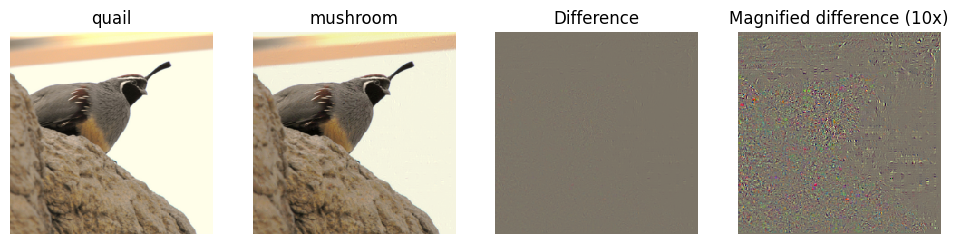

In [25]:
# Index of the image to modify and the target class
idx = 1
target_y = class_names_to_id['mushroom']

# Preparation of tensor X and it's "fooling" version
X_tensor = torch.cat([preprocess(Image.fromarray(x)) for x in X], dim=0)
X_fooling = make_fooling_image(X_tensor[idx:idx+1], target_y, model)

# Check the predicted class
scores = model(X_fooling)
assert target_y == scores.data.max(1)[1][0], 'The model is not fooled!'

# Display
X_fooling_np = deprocess(X_fooling.clone())
X_fooling_np = np.asarray(X_fooling_np).astype(np.uint8)

plt.subplot(1, 4, 1)
plt.imshow(X[idx])
plt.title(class_names[y[idx]])
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(X_fooling_np)
plt.title(class_names[target_y])
plt.axis('off')

plt.subplot(1, 4, 3)
X_pre = preprocess(Image.fromarray(X[idx]))
diff = np.asarray(deprocess(X_fooling - X_pre, should_rescale=False))
plt.imshow(diff)
plt.title('Difference')
plt.axis('off')

plt.subplot(1, 4, 4)
diff = np.asarray(deprocess(10 * (X_fooling - X_pre), should_rescale=False))
plt.imshow(diff)
plt.title('Magnified difference (10x)')
plt.axis('off')

plt.gcf().set_size_inches(12, 5)
plt.savefig("quail_vs_mushroom.png", dpi=100, bbox_inches="tight")
plt.show()

test with `bee eater`

Iteration 1: target score 15.704, max score 25.148
Iteration 2: target score 21.632, max score 29.274
Iteration 3: target score 27.621, max score 33.813
Iteration 4: target score 33.673, max score 37.801
Iteration 5: target score 39.605, max score 41.466
Iteration 6: target score 46.023, max score 46.023
The model is fooled.


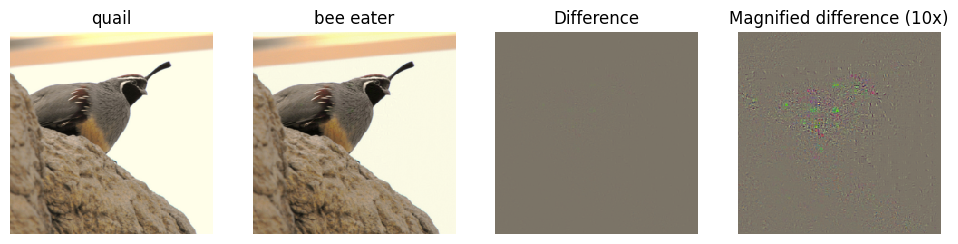

In [26]:
# Index of the image to modify and the target class
idx = 1
target_y = class_names_to_id['bee eater']

# Preparation of tensor X and it's "fooling" version
X_tensor = torch.cat([preprocess(Image.fromarray(x)) for x in X], dim=0)
X_fooling = make_fooling_image(X_tensor[idx:idx+1], target_y, model)

# Check the predicted class
scores = model(X_fooling)
assert target_y == scores.data.max(1)[1][0], 'The model is not fooled!'

# Display
X_fooling_np = deprocess(X_fooling.clone())
X_fooling_np = np.asarray(X_fooling_np).astype(np.uint8)

plt.subplot(1, 4, 1)
plt.imshow(X[idx])
plt.title(class_names[y[idx]])
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(X_fooling_np)
plt.title(class_names[target_y])
plt.axis('off')

plt.subplot(1, 4, 3)
X_pre = preprocess(Image.fromarray(X[idx]))
diff = np.asarray(deprocess(X_fooling - X_pre, should_rescale=False))
plt.imshow(diff)
plt.title('Difference')
plt.axis('off')

plt.subplot(1, 4, 4)
diff = np.asarray(deprocess(10 * (X_fooling - X_pre), should_rescale=False))
plt.imshow(diff)
plt.title('Magnified difference (10x)')
plt.axis('off')

plt.gcf().set_size_inches(12, 5)
plt.savefig("quail_vs_bee_eater.png", dpi=100, bbox_inches="tight")
plt.show()

#### test with different input images

Iteration 1: target score 21.519, max score 26.988
Iteration 2: target score 27.480, max score 32.891
Iteration 3: target score 33.230, max score 37.701
Iteration 4: target score 38.287, max score 41.635
Iteration 5: target score 42.314, max score 44.696
Iteration 6: target score 45.705, max score 47.758
Iteration 7: target score 49.374, max score 50.686
Iteration 8: target score 52.706, max score 53.165
Iteration 9: target score 55.497, max score 55.590
Iteration 10: target score 58.313, max score 58.313
The model is fooled.


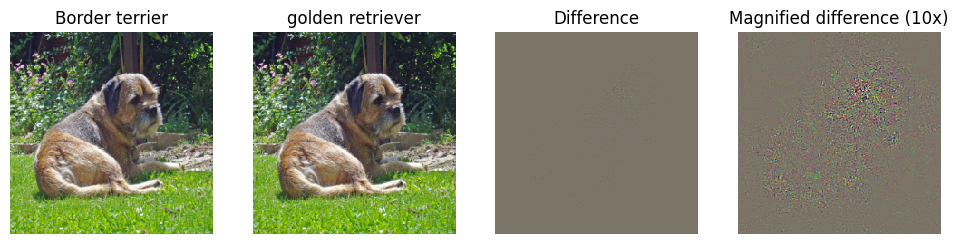

In [27]:
# Index of the image to modify and the target class
idx = 3
target_y = class_names_to_id['golden retriever']

# Preparation of tensor X and it's "fooling" version
X_tensor = torch.cat([preprocess(Image.fromarray(x)) for x in X], dim=0)
X_fooling = make_fooling_image(X_tensor[idx:idx+1], target_y, model)

# Check the predicted class
scores = model(X_fooling)
assert target_y == scores.data.max(1)[1][0], 'The model is not fooled!'

# Display
X_fooling_np = deprocess(X_fooling.clone())
X_fooling_np = np.asarray(X_fooling_np).astype(np.uint8)

plt.subplot(1, 4, 1)
plt.imshow(X[idx])
plt.title(class_names[y[idx]])
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(X_fooling_np)
plt.title(class_names[target_y])
plt.axis('off')

plt.subplot(1, 4, 3)
X_pre = preprocess(Image.fromarray(X[idx]))
diff = np.asarray(deprocess(X_fooling - X_pre, should_rescale=False))
plt.imshow(diff)
plt.title('Difference')
plt.axis('off')

plt.subplot(1, 4, 4)
diff = np.asarray(deprocess(10 * (X_fooling - X_pre), should_rescale=False))
plt.imshow(diff)
plt.title('Magnified difference (10x)')
plt.axis('off')

plt.gcf().set_size_inches(12, 5)
plt.savefig("terrier_vs_golden_retriever.png", dpi=100, bbox_inches="tight")
plt.show()

Iteration 1: target score 20.674, max score 26.988
Iteration 2: target score 26.239, max score 30.536
Iteration 3: target score 31.580, max score 34.870
Iteration 4: target score 36.967, max score 38.790
Iteration 5: target score 41.742, max score 42.542
Iteration 6: target score 46.311, max score 46.311
The model is fooled.


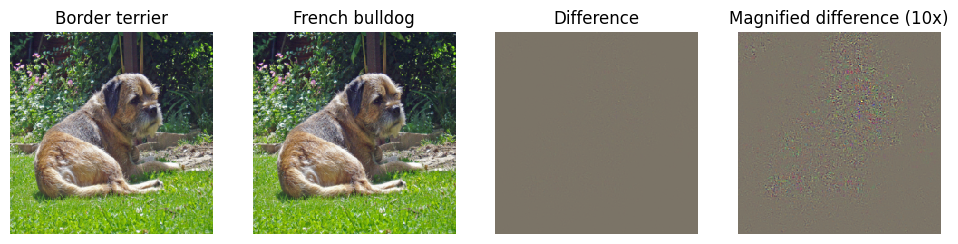

In [28]:
# Index of the image to modify and the target class
idx = 3
target_y = class_names_to_id['French bulldog']

# Preparation of tensor X and it's "fooling" version
X_tensor = torch.cat([preprocess(Image.fromarray(x)) for x in X], dim=0)
X_fooling = make_fooling_image(X_tensor[idx:idx+1], target_y, model)

# Check the predicted class
scores = model(X_fooling)
assert target_y == scores.data.max(1)[1][0], 'The model is not fooled!'

# Display
X_fooling_np = deprocess(X_fooling.clone())
X_fooling_np = np.asarray(X_fooling_np).astype(np.uint8)

plt.subplot(1, 4, 1)
plt.imshow(X[idx])
plt.title(class_names[y[idx]])
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(X_fooling_np)
plt.title(class_names[target_y])
plt.axis('off')

plt.subplot(1, 4, 3)
X_pre = preprocess(Image.fromarray(X[idx]))
diff = np.asarray(deprocess(X_fooling - X_pre, should_rescale=False))
plt.imshow(diff)
plt.title('Difference')
plt.axis('off')

plt.subplot(1, 4, 4)
diff = np.asarray(deprocess(10 * (X_fooling - X_pre), should_rescale=False))
plt.imshow(diff)
plt.title('Magnified difference (10x)')
plt.axis('off')

plt.gcf().set_size_inches(12, 5)
plt.savefig("terrier_vs_french_bulldog.png", dpi=100, bbox_inches="tight")
plt.show()

Iteration 1: target score 3.657, max score 26.988
Iteration 2: target score 6.036, max score 27.302
Iteration 3: target score 8.645, max score 27.753
Iteration 4: target score 11.073, max score 29.354
Iteration 5: target score 13.401, max score 31.973
Iteration 6: target score 15.481, max score 33.645
Iteration 7: target score 17.448, max score 35.322
Iteration 8: target score 19.247, max score 36.102
Iteration 9: target score 20.728, max score 37.570
Iteration 10: target score 22.450, max score 38.927
Iteration 11: target score 24.125, max score 40.376
Iteration 12: target score 25.426, max score 41.466
Iteration 13: target score 26.827, max score 43.066
Iteration 14: target score 28.039, max score 43.298
Iteration 15: target score 29.427, max score 44.985
Iteration 16: target score 30.654, max score 45.715
Iteration 17: target score 31.857, max score 46.920
Iteration 18: target score 32.937, max score 47.652
Iteration 19: target score 34.138, max score 48.512
Iteration 20: target sco

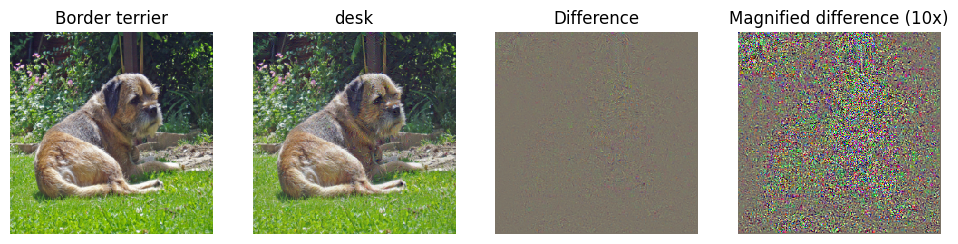

In [29]:
# Index of the image to modify and the target class
idx = 3
target_y = class_names_to_id['desk']

# Preparation of tensor X and it's "fooling" version
X_tensor = torch.cat([preprocess(Image.fromarray(x)) for x in X], dim=0)
X_fooling = make_fooling_image(X_tensor[idx:idx+1], target_y, model)

# Check the predicted class
scores = model(X_fooling)
assert target_y == scores.data.max(1)[1][0], 'The model is not fooled!'

# Display
X_fooling_np = deprocess(X_fooling.clone())
X_fooling_np = np.asarray(X_fooling_np).astype(np.uint8)

plt.subplot(1, 4, 1)
plt.imshow(X[idx])
plt.title(class_names[y[idx]])
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(X_fooling_np)
plt.title(class_names[target_y])
plt.axis('off')

plt.subplot(1, 4, 3)
X_pre = preprocess(Image.fromarray(X[idx]))
diff = np.asarray(deprocess(X_fooling - X_pre, should_rescale=False))
plt.imshow(diff)
plt.title('Difference')
plt.axis('off')

plt.subplot(1, 4, 4)
diff = np.asarray(deprocess(10 * (X_fooling - X_pre), should_rescale=False))
plt.imshow(diff)
plt.title('Magnified difference (10x)')
plt.axis('off')

plt.gcf().set_size_inches(12, 5)
plt.savefig("terrier_vs_desk.png", dpi=100, bbox_inches="tight")
plt.show()

# Class visualization

Write the code which generates an image maximizing the score of a class, subject to a certain number of regularizations. See the TP guide for details.


In [9]:
def create_class_visualization(target_y, model, dtype, init_img=None, l2_reg=1e-3, learning_rate=5,
                               num_iterations=200, blur_every=10, max_jitter=16, show_every=25):
    """
    Generate an image to maximize the score of target_y under a pretrained model.

    Inputs:
    - target_y: Integer in the range [0, 1000) giving the index of the class
    - model: A pretrained CNN that will be used to generate the image
    - dtype: Torch datatype to use for computations

    Keyword arguments:
    - init_img: Initial image to use (if None, will be random)
    - l2_reg: Strength of L2 regularization on the image
    - learning_rate: How big of a step to take
    - num_iterations: How many iterations to use
    - blur_every: How often to blur the image as an implicit regularizer
    - max_jitter: How much to gjitter the image as an implicit regularizer
    - show_every: How often to show the intermediate result
    """
    model.type(dtype)

    # Randomly initialize the image as a PyTorch Tensor
    if init_img is None:
        img = torch.randn(1, 3, 224, 224).mul_(1.0).type(dtype).detach()
    else:
        img = init_img.clone().mul_(1.0).type(dtype).detach()
    img.requires_grad = True
    images=[]
    for t in range(num_iterations):
        # Randomly jitter the image a bit; this gives slightly nicer results
        ox, oy = random.randint(0, max_jitter), random.randint(0, max_jitter)
        img = (jitter(img, ox, oy)).clone().detach()
        img.requires_grad = True

        ########################################################################
        # - TODO: Use the model to compute the gradient of the score for the   #
        # class target_y with respect to the pixels of the image, and make a   #
        # gradient step on the image using the learning rate. Don't forget the #
        # L2 regularization term!                                              #
        # - Be very careful about the signs of elements in your code.          #
        # - Advice: compute backward on the raw logits (not the loss), it      #
        # works better                                                         #
        ########################################################################
        # forward pass
        scores=model(img) #(1,1000)
        # get target score
        target_score=scores[:,target_y].squeeze()
        # add L2 regularizarion term (squared according to the Simonyan et al. (2014) paper)
        target_score-=l2_reg*torch.square(torch.linalg.norm(img))
        # backward pass
        target_score.backward()
        # update the gradient ascent
        img.data+=learning_rate*img.grad
        # reset gradients at each step
        img.grad.data.zero_()


        ########################################################################
        #                             END OF YOUR CODE                         #
        ########################################################################

        # Undo the random jitter
        img.data.copy_(jitter(img, -ox, -oy))
        img = img.clone()


        # As regularizer, clamp and periodically blur the image
        for c in range(3):
            lo = float(-SQUEEZENET_MEAN[c] / SQUEEZENET_STD[c])
            hi = float((1.0 - SQUEEZENET_MEAN[c]) / SQUEEZENET_STD[c])
            img[:, c].clamp_(min=lo, max=hi)
        if t % blur_every == 0:
            blur_image(img, sigma=0.5)

        # Periodically show the image
        if t == 0 or (t + 1) % show_every == 0 or t == num_iterations - 1:
            plt.imshow(deprocess(img.clone().cpu()))
            class_name = class_names[target_y]
            plt.title('%s\nIteration %d / %d' % (class_name, t + 1, num_iterations))
            plt.gcf().set_size_inches(4, 4)
            plt.axis('off')
            plt.show()


    return deprocess(img.cpu())

Test with various classes and starting from random noise:

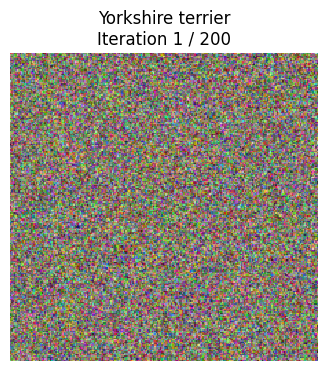

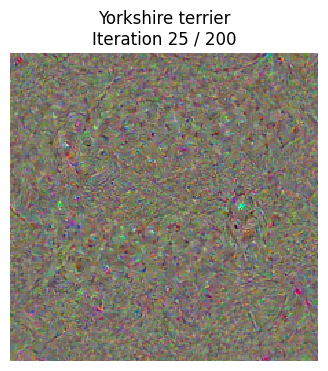

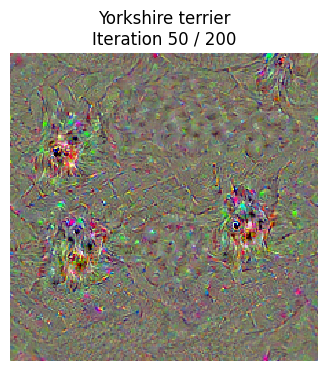

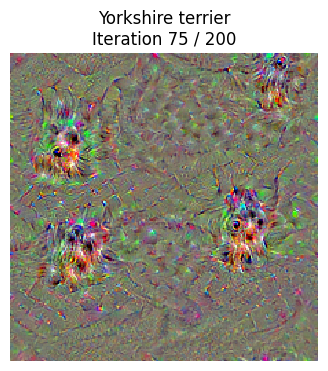

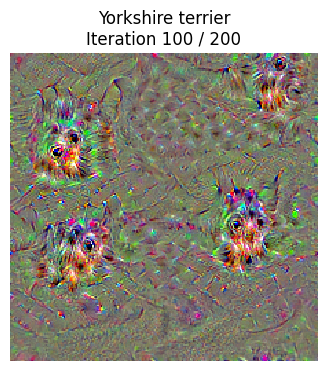

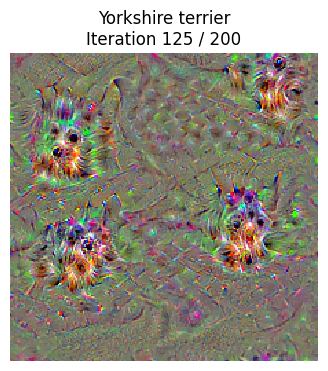

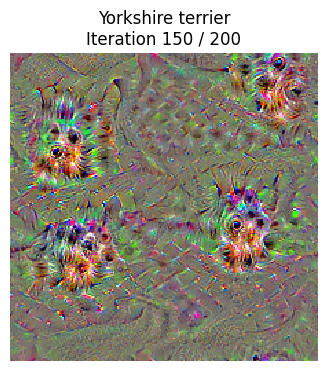

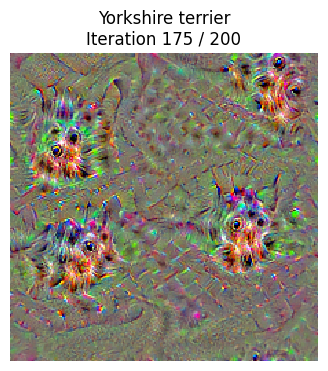

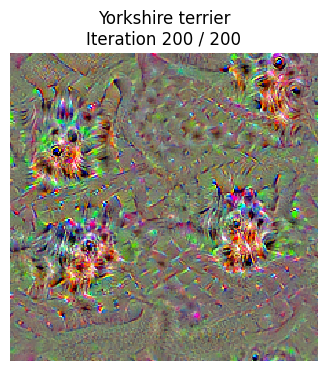

In [7]:
dtype = torch.FloatTensor
# dtype = torch.cuda.FloatTensor # Uncomment this to use GPU
model.type(dtype)

# target_y = 76 # Tarantula
# target_y = 78 # Tick
target_y = 187 # Yorkshire Terrier
# target_y = 683 # Oboe
# target_y = 366 # Gorilla
# target_y = 604 # Hourglass
# target_y = 113 # Snail
# target_y = np.random.randint(1000) # Classe aléatoire


out = create_class_visualization(target_y, model, dtype, show_every=25, num_iterations=200)

### number of iterations

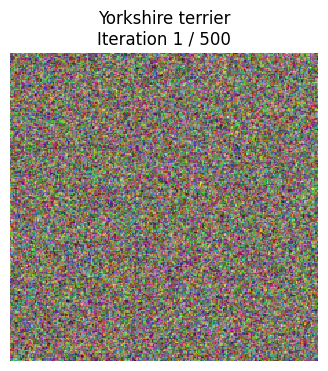

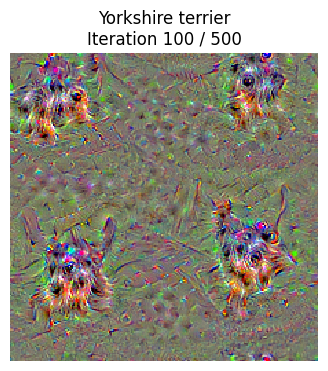

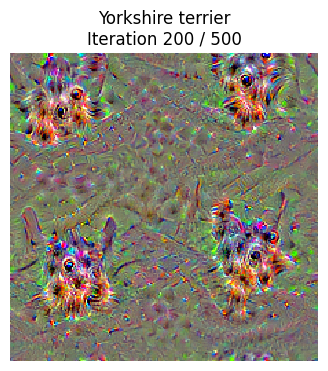

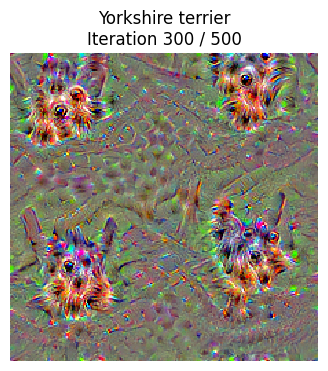

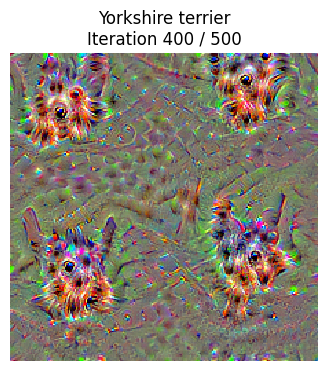

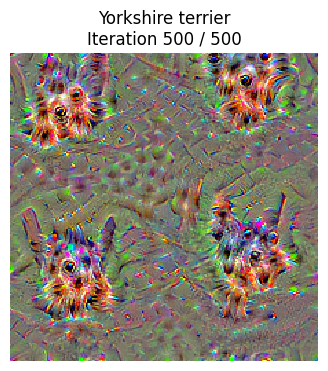

In [32]:

out = create_class_visualization(target_y, model, dtype, show_every=100, num_iterations=500)

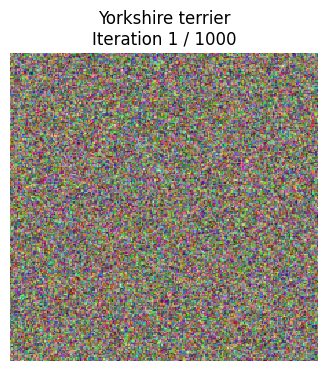

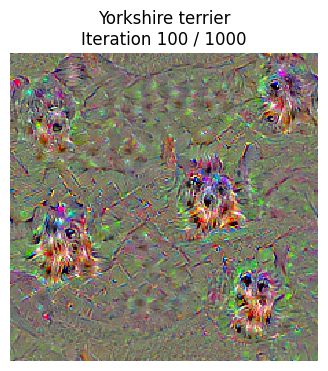

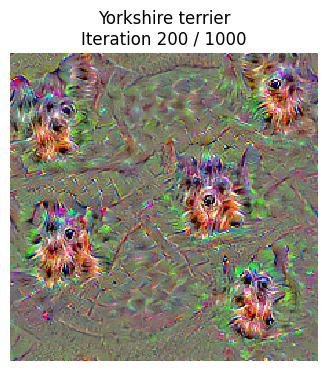

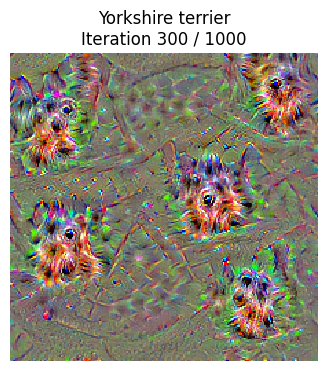

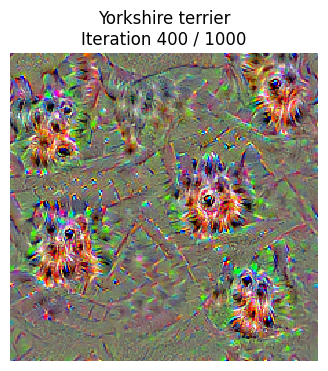

...

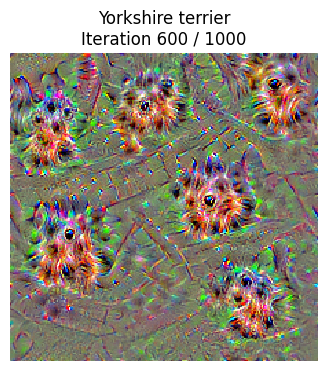

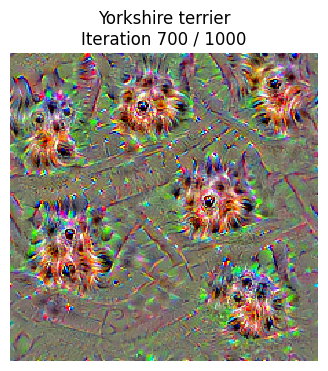

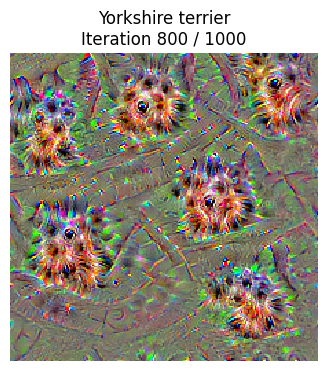

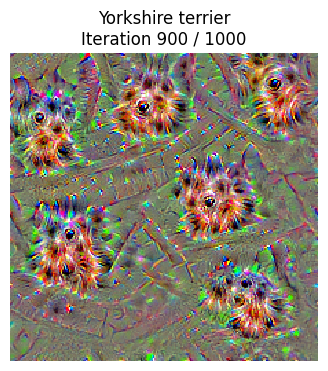

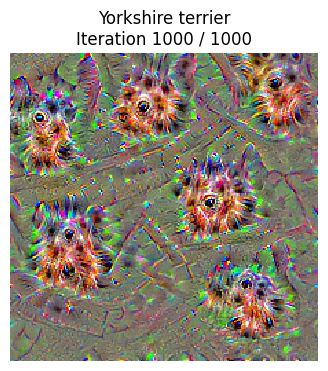

In [33]:
out = create_class_visualization(target_y, model, dtype, show_every=100, num_iterations=1000)



### learning rate

original learning rate=5

test with learning rate=0.1,10

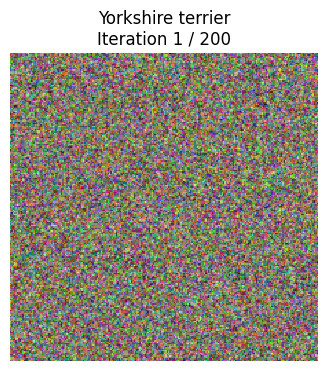

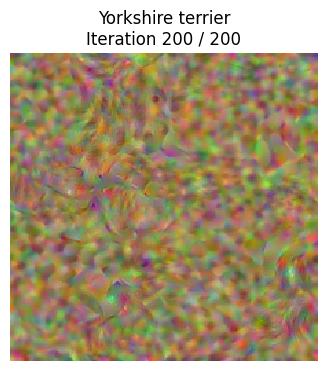

In [34]:
out = create_class_visualization(target_y, model, dtype, learning_rate=0.1, show_every=200, num_iterations=200)

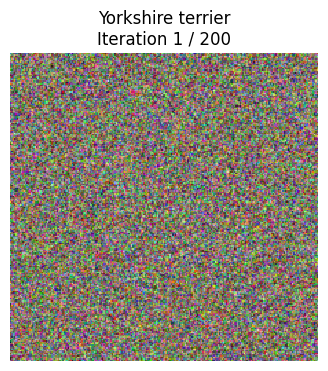

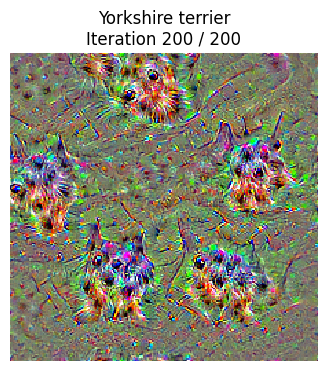

In [35]:
out = create_class_visualization(target_y, model, dtype, learning_rate=10, show_every=200, num_iterations=200)

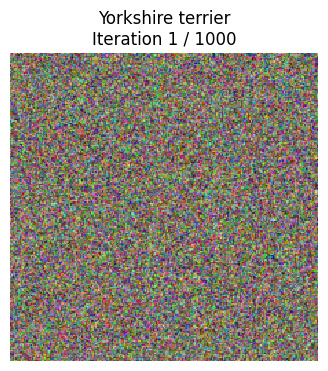

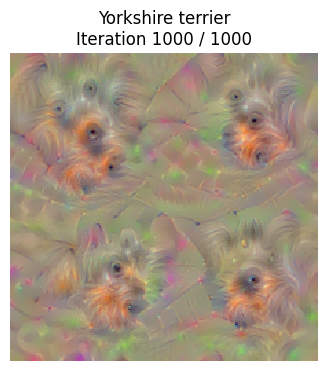

In [36]:
out = create_class_visualization(target_y, model, dtype, learning_rate=0.1, show_every=1000, num_iterations=1000)

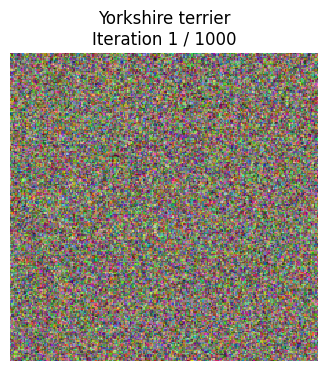

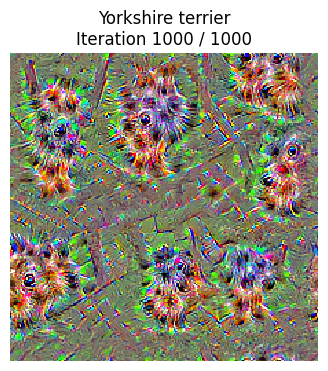

In [37]:
out = create_class_visualization(target_y, model, dtype, learning_rate=10, show_every=1000, num_iterations=1000)

### L2-regularization


original 12-reg=1e-3

test with l2-reg= 1e-2,1e-5

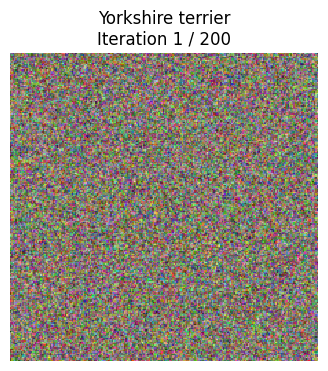

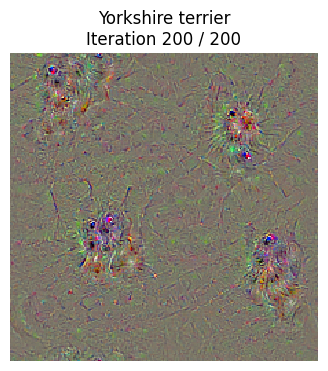

In [38]:
out = create_class_visualization(target_y, model, dtype, l2_reg=1e-2, show_every=200, num_iterations=200)

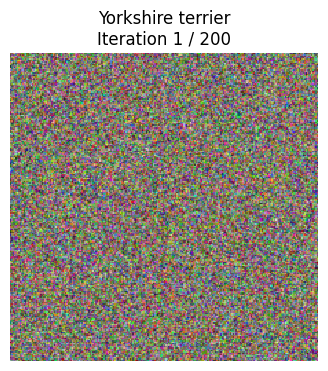

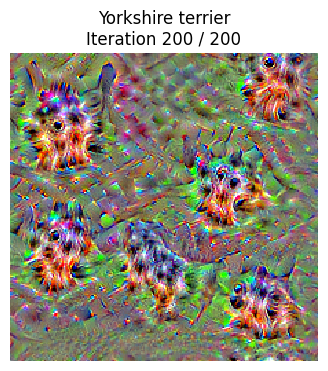

In [39]:
out = create_class_visualization(target_y, model, dtype, l2_reg=1e-5, show_every=200, num_iterations=200)

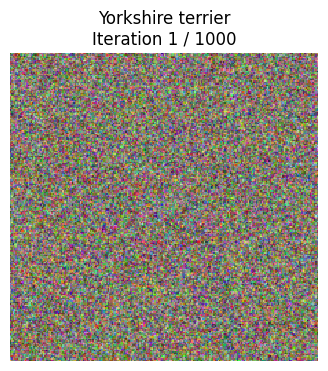

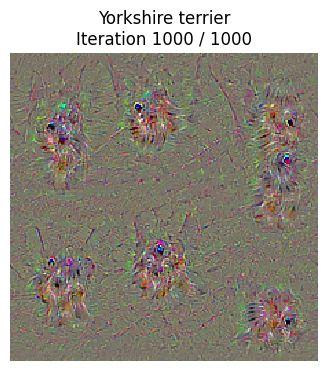

In [40]:
out = create_class_visualization(target_y, model, dtype, l2_reg=1e-2, show_every=1000, num_iterations=1000)

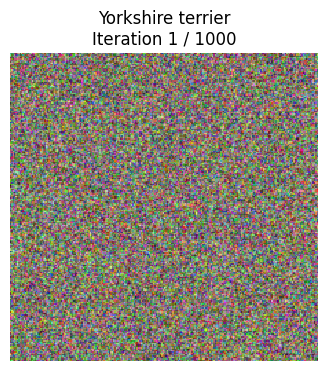

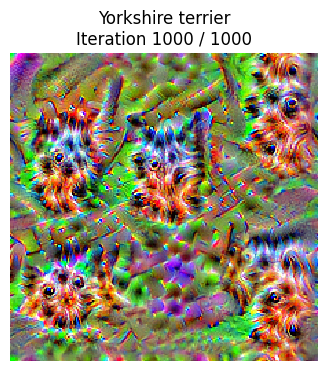

In [41]:
out = create_class_visualization(target_y, model, dtype, l2_reg=1e-5, show_every=1000, num_iterations=1000)

### blur frequency
original blur_every=10

test with blur_every=2,20,no blur

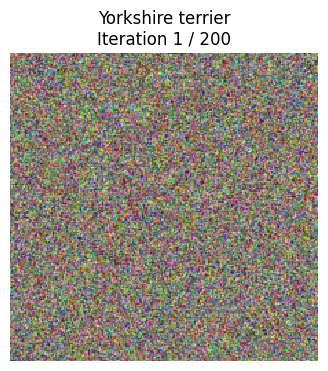

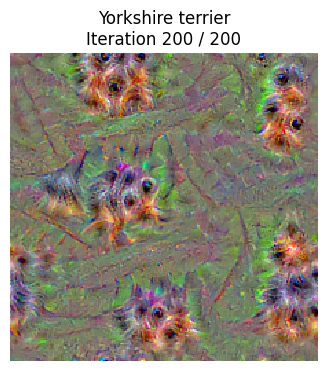

In [42]:
out = create_class_visualization(target_y, model, dtype, blur_every=2, show_every=200, num_iterations=200)

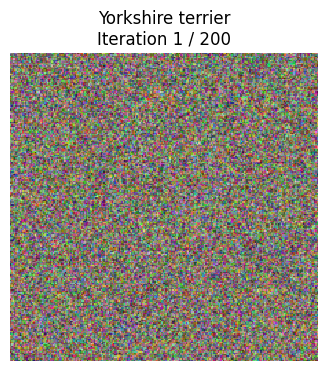

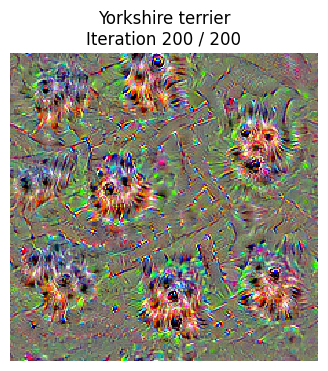

In [43]:
out = create_class_visualization(target_y, model, dtype, blur_every=20, show_every=200, num_iterations=200)

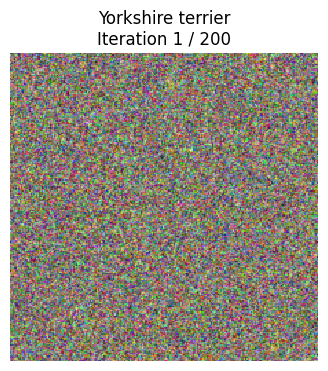

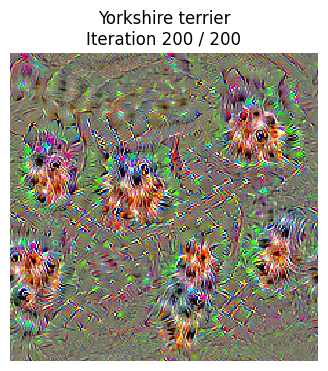

In [44]:
out = create_class_visualization(target_y, model, dtype, blur_every=200, show_every=200, num_iterations=200)

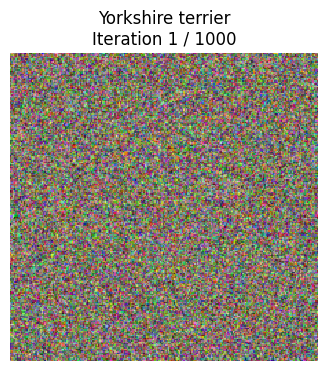

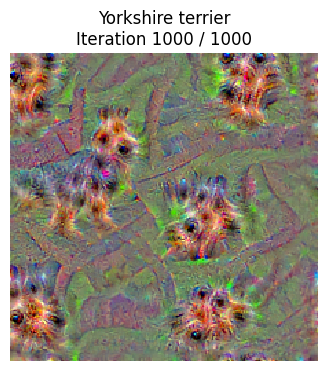

In [45]:
out = create_class_visualization(target_y, model, dtype, blur_every=2, show_every=1000, num_iterations=1000)

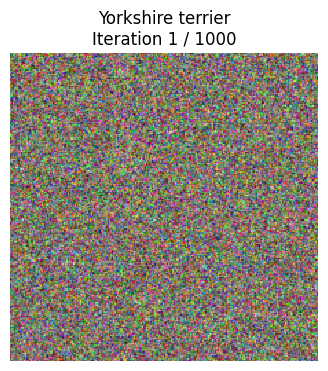

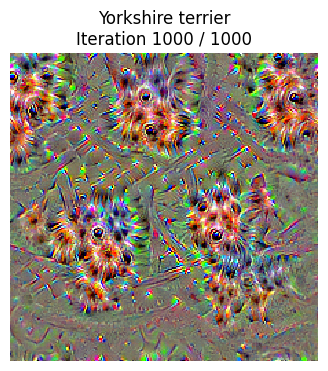

In [8]:
out = create_class_visualization(target_y, model, dtype, blur_every=20, show_every=1000, num_iterations=1000)

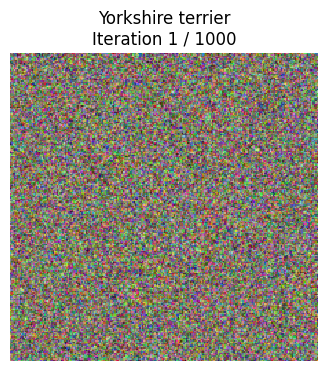

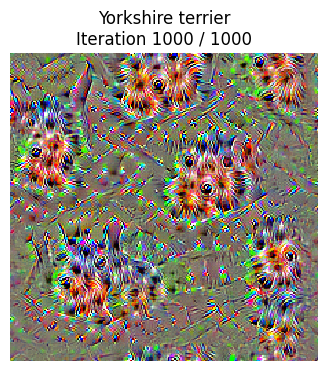

In [9]:
out = create_class_visualization(target_y, model, dtype, blur_every=1000, show_every=1000, num_iterations=1000)

###Test by starting from an image from ImageNet:

use the real class as target class

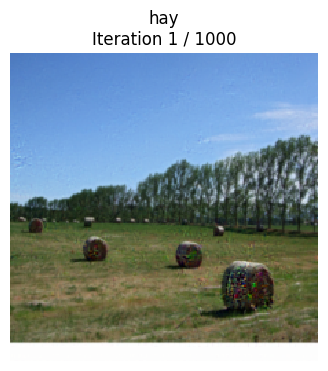

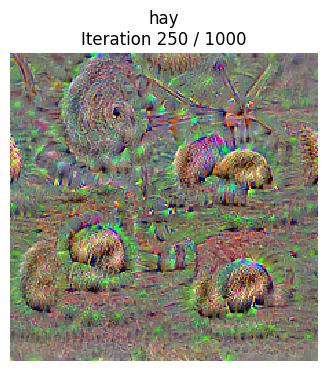

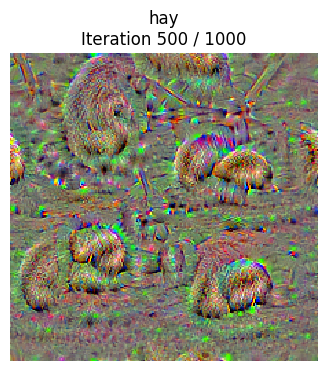

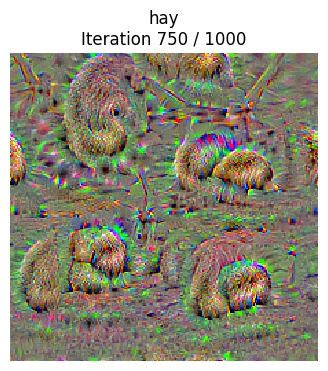

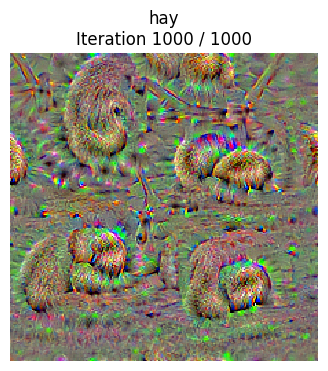

In [46]:
# Initialize test
img_ind = 0

target_y = 958 # hay
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[img_ind])))
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, show_every=250, num_iterations=1000)

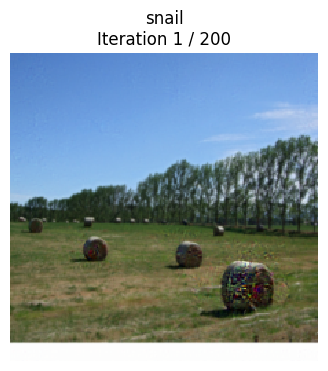

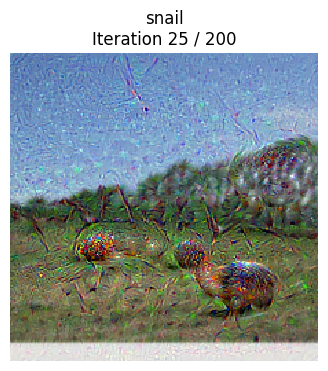

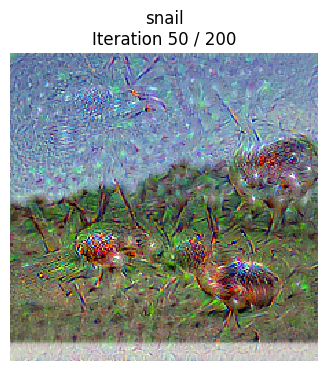

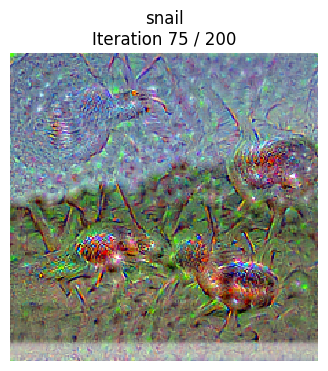

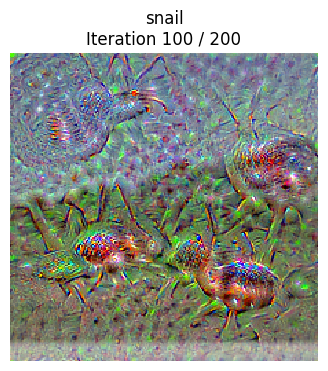

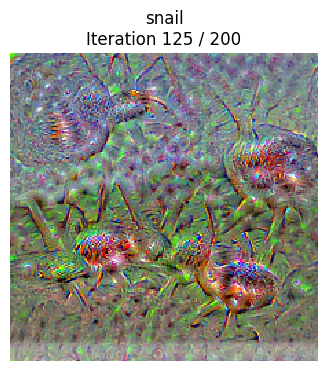

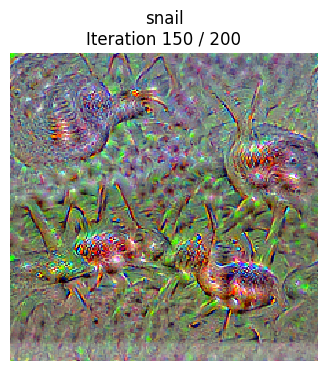

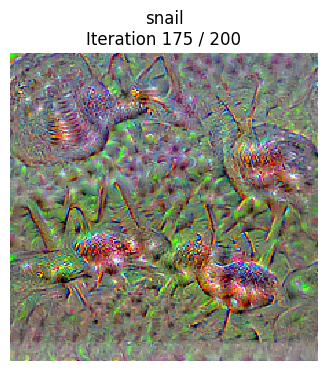

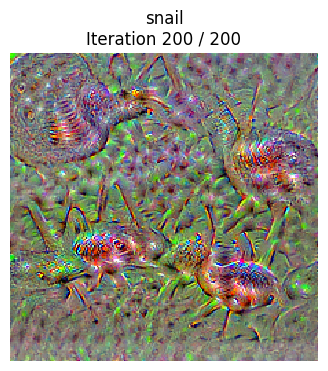

In [47]:
# Initialize test
img_ind = 0

target_y = 113 # snail
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[img_ind])))
out = create_class_visualization(target_y, model, dtype, init_img=X_tensor, show_every=25, num_iterations=200)

### test with other network, vgg16 for example

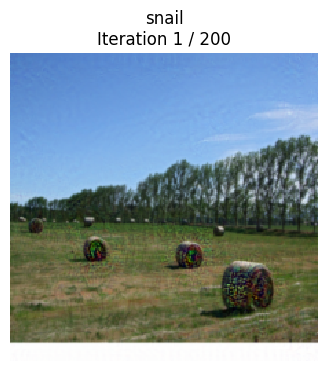

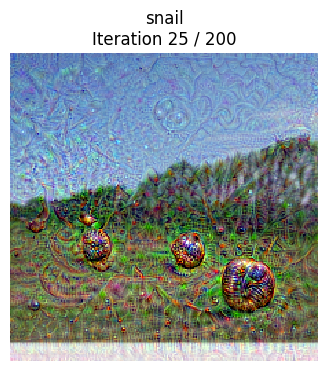

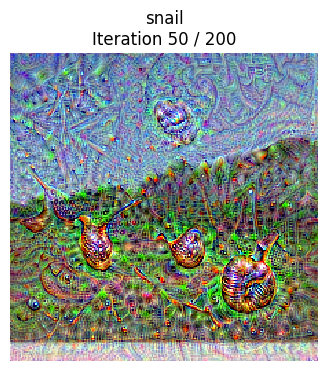

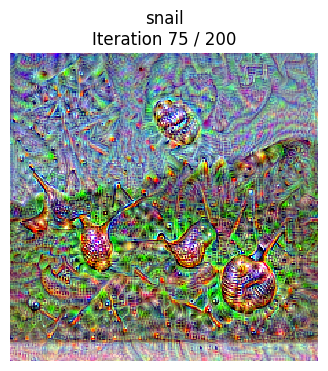

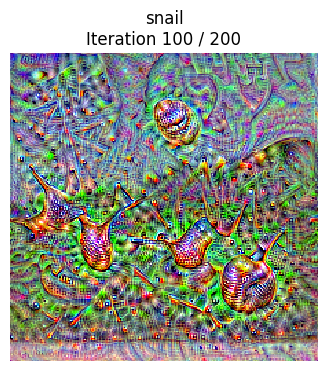

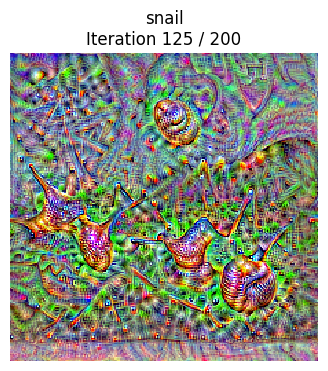

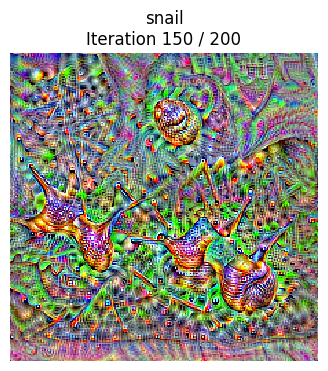

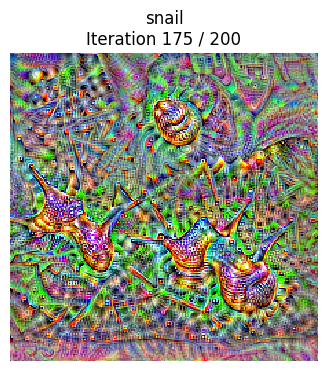

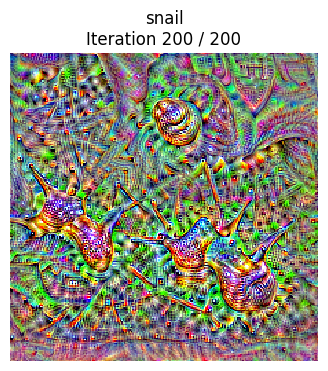

In [48]:
out = create_class_visualization(target_y, vgg16, dtype, init_img=X_tensor, show_every=25, num_iterations=200)

#### vgg16 comparison

default vgg16

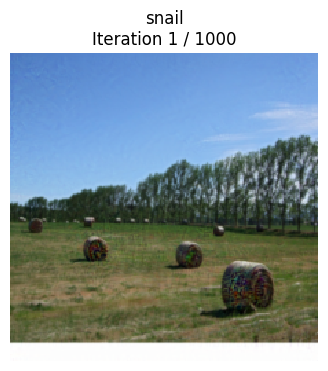

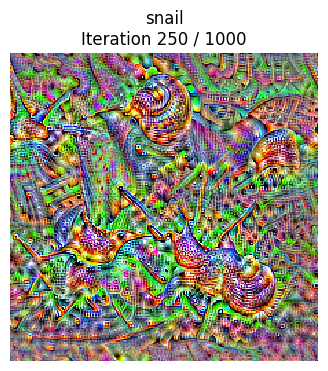

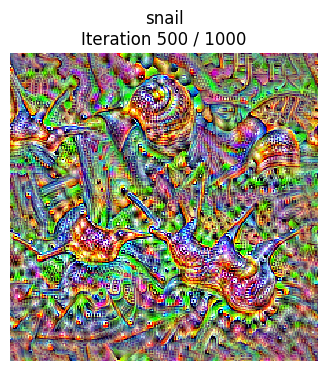

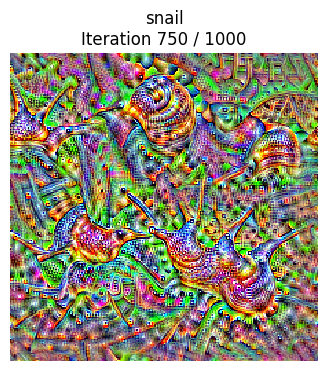

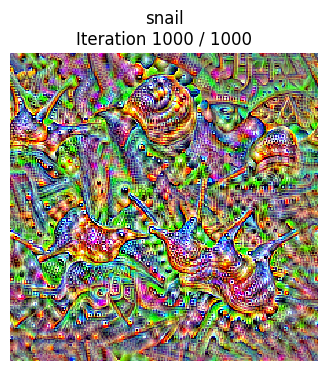

In [50]:
out = create_class_visualization(target_y, vgg16, dtype, init_img=X_tensor, show_every=250, num_iterations=1000)

self to self with default parameters

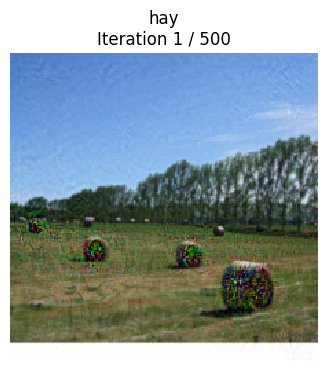

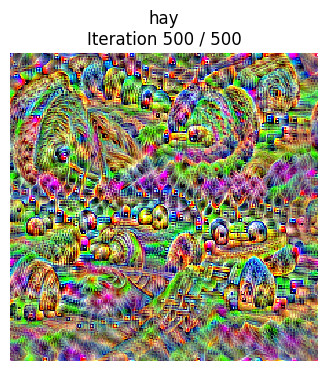

In [11]:
dtype = torch.FloatTensor
img_ind = 0

target_y = 958 # hay
X_tensor = torch.Tensor(preprocess(Image.fromarray(X[img_ind])))
out = create_class_visualization(target_y, vgg16, dtype, init_img=X_tensor, learning_rate=5,show_every=500, num_iterations=500)

self to self with learning rate:

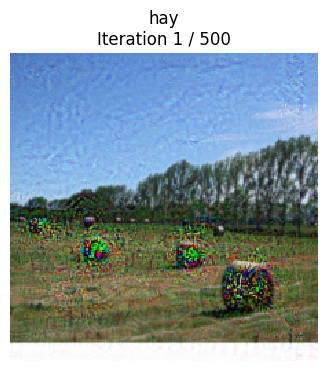

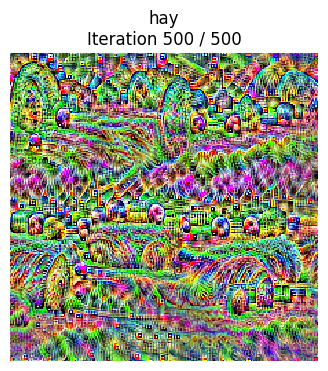

In [12]:
out = create_class_visualization(target_y, vgg16, dtype, init_img=X_tensor, learning_rate=10,show_every=500, num_iterations=500)

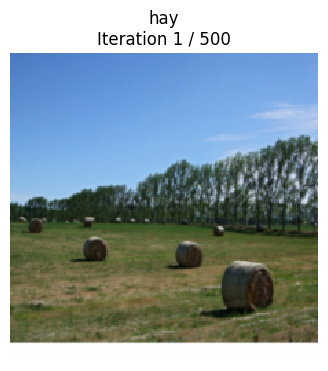

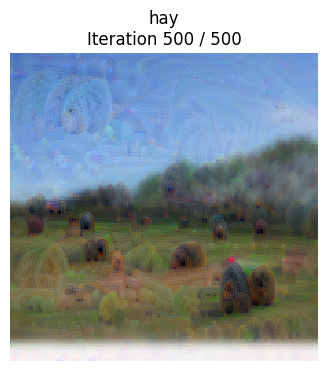

In [13]:
out = create_class_visualization(target_y, vgg16, dtype, init_img=X_tensor, learning_rate=0.1,show_every=500, num_iterations=500)

with lower L2-reg

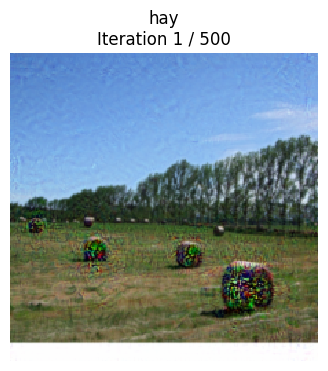

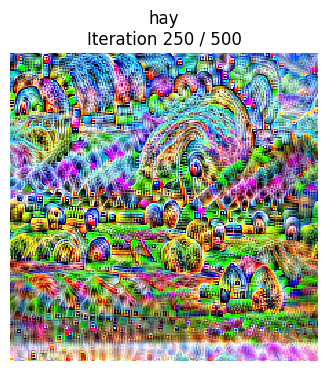

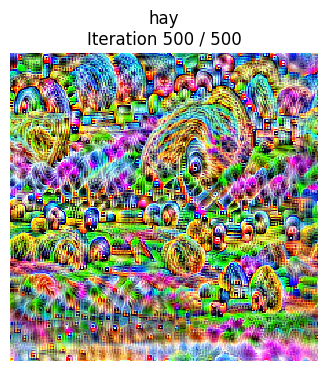

In [63]:
out = create_class_visualization(target_y, vgg16, dtype, init_img=X_tensor, l2_reg=1e-5,show_every=250, num_iterations=500)

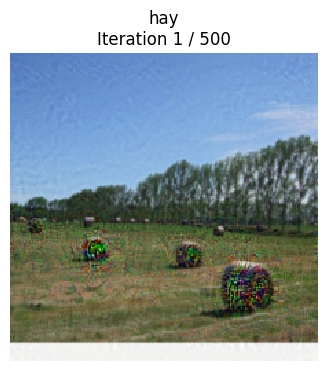

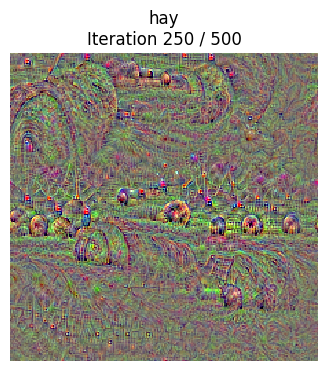

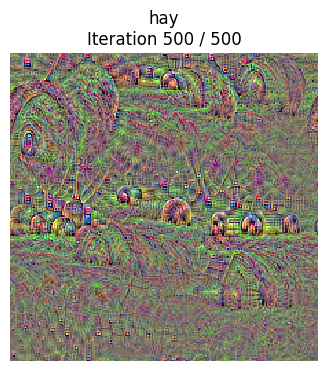

In [62]:
out = create_class_visualization(target_y, vgg16, dtype, init_img=X_tensor, l2_reg=1e-2,show_every=250, num_iterations=500)

with higher blur frequency

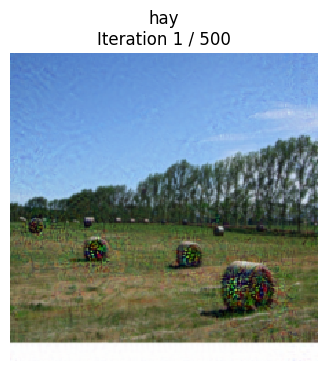

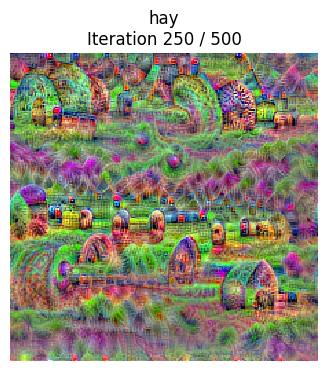

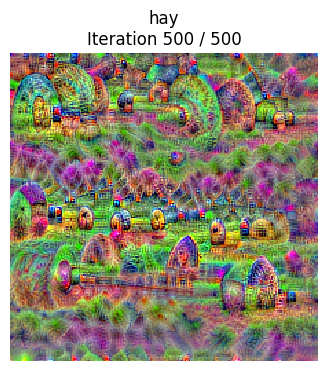

In [64]:
out = create_class_visualization(target_y, vgg16, dtype, init_img=X_tensor, blur_every=2 ,show_every=250, num_iterations=500)

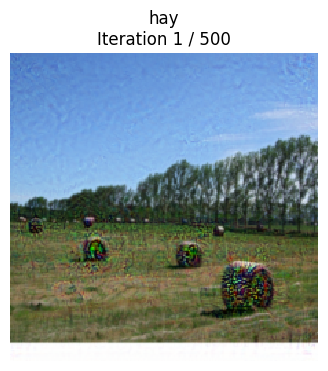

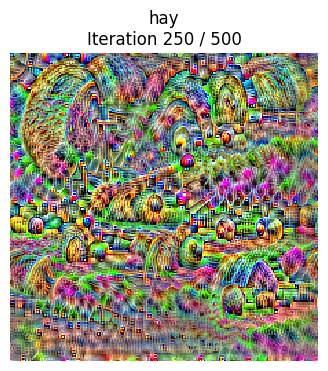

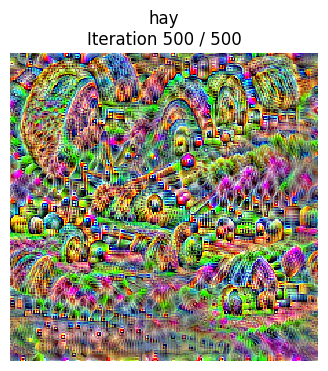

In [65]:
out = create_class_visualization(target_y, vgg16, dtype, init_img=X_tensor, blur_every=10 ,show_every=250, num_iterations=500)